In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import configparser
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
# Root directory for dataset
#dataroot = "Pictures"
dataroot = "Dataset"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 64

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 256

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 1024

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [5]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

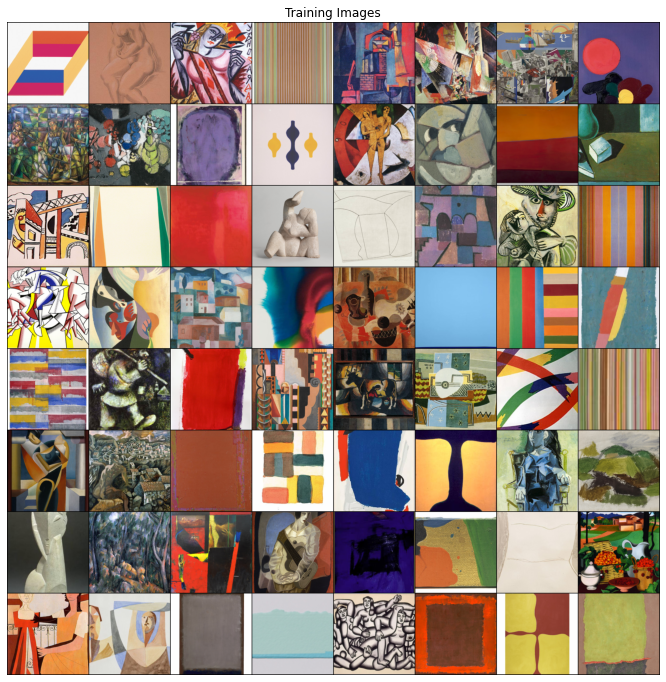

In [6]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:1" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(12,12))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [8]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 32, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 32),
            nn.ReLU(True),
            nn.ConvTranspose2d(     ngf*32, ngf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(    ngf,      nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )
    def forward(self, input):
        return self.main(input)

In [8]:
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Print the model
print(sum(p.numel() for p in netG.parameters()))

78261120


In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, stride=2, padding=1, bias=False), 
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, ndf * 16, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 16, ndf * 32, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 32),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 32, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )
    def forward(self, input):
        return self.main(input)

In [11]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Print the model
print(sum(p.numel() for p in netD.parameters()))

44739328


In [10]:
#netG = torch.load('GENERATOR256')
#netD = torch.load("DISCRIMINATOR256")

In [11]:
print(sum(p.numel() for p in netD.parameters()))

44739328


In [12]:
print(sum(p.numel() for p in netG.parameters()))

78261120


In [13]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=0.00015, betas=(beta1, 0.999))#0.0002
optimizerG = optim.Adam(netG.parameters(), lr=0.00015, betas=(beta1, 0.999))#0.00007

In [14]:
img_list = []
G_losses = []
D_losses = []
iters = 0
print("Starting Training Loop...")
# For each epoch
#for epoch in range(num_epochs):
for epoch in range(30):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

      
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 20 == 0 and i != 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.9f\tLoss_G: %.9f\tD(x): %.6f\tD(G(z)): %.6f / %.6f'
                  % (epoch+1, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        
            
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 100 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=0, normalize=True))

        iters += 1
print('GAN is trained')

Starting Training Loop...
[1/100][20/64]	Loss_D: 0.000129407	Loss_G: 12.143506050	D(x): 0.999921	D(G(z)): 0.000051 / 0.000024
[1/100][40/64]	Loss_D: 0.000061796	Loss_G: 23.007728577	D(x): 0.999938	D(G(z)): 0.000000 / 0.000000
[1/100][60/64]	Loss_D: 0.000979672	Loss_G: 10.128845215	D(x): 0.999910	D(G(z)): 0.000889 / 0.000172
[2/100][20/64]	Loss_D: 0.000029500	Loss_G: 12.239135742	D(x): 0.999989	D(G(z)): 0.000018 / 0.000014
[2/100][40/64]	Loss_D: 0.000048193	Loss_G: 37.522403717	D(x): 0.999952	D(G(z)): 0.000000 / 0.000000
[2/100][60/64]	Loss_D: 0.000409246	Loss_G: 22.507877350	D(x): 0.999916	D(G(z)): 0.000323 / 0.000248
[3/100][20/64]	Loss_D: 0.001978244	Loss_G: 14.179439545	D(x): 0.998482	D(G(z)): 0.000407 / 0.000220
[3/100][40/64]	Loss_D: 0.000025443	Loss_G: 21.634162903	D(x): 0.999981	D(G(z)): 0.000007 / 0.000037
[3/100][60/64]	Loss_D: 0.002658365	Loss_G: 8.666670799	D(x): 0.999967	D(G(z)): 0.002613 / 0.001426
[4/100][20/64]	Loss_D: 0.009117561	Loss_G: 11.148044586	D(x): 0.999961	D(G(

[28/100][40/64]	Loss_D: 0.007480577	Loss_G: 7.607185364	D(x): 0.999467	D(G(z)): 0.006849 / 0.003525
[28/100][60/64]	Loss_D: 0.101506405	Loss_G: 5.542104721	D(x): 0.958377	D(G(z)): 0.030689 / 0.009229
[29/100][20/64]	Loss_D: 0.069769368	Loss_G: 4.940006256	D(x): 0.964554	D(G(z)): 0.017587 / 0.014873
[29/100][40/64]	Loss_D: 0.044162884	Loss_G: 4.824717045	D(x): 0.999945	D(G(z)): 0.042366 / 0.018621
[29/100][60/64]	Loss_D: 0.008056577	Loss_G: 8.530628204	D(x): 0.994290	D(G(z)): 0.001100 / 0.000582
[30/100][20/64]	Loss_D: 0.084186226	Loss_G: 19.762107849	D(x): 0.999792	D(G(z)): 0.017378 / 0.001417
[30/100][40/64]	Loss_D: 0.012627894	Loss_G: 12.301401138	D(x): 0.999911	D(G(z)): 0.011820 / 0.005888
[30/100][60/64]	Loss_D: 0.028669767	Loss_G: 8.059962273	D(x): 0.999634	D(G(z)): 0.026767 / 0.009246
GAN is trained


In [62]:
torch.save(netG, 'GENERATOR256')
torch.save(netD, 'DISCRIMINATOR256')

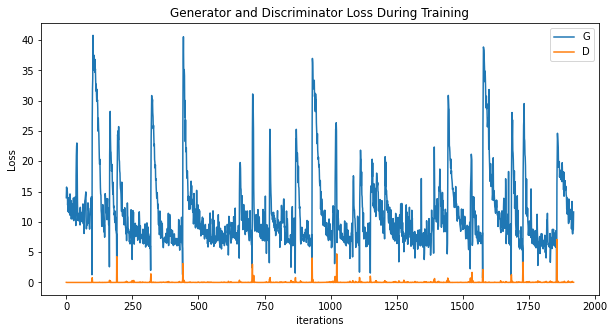

In [15]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21203018 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


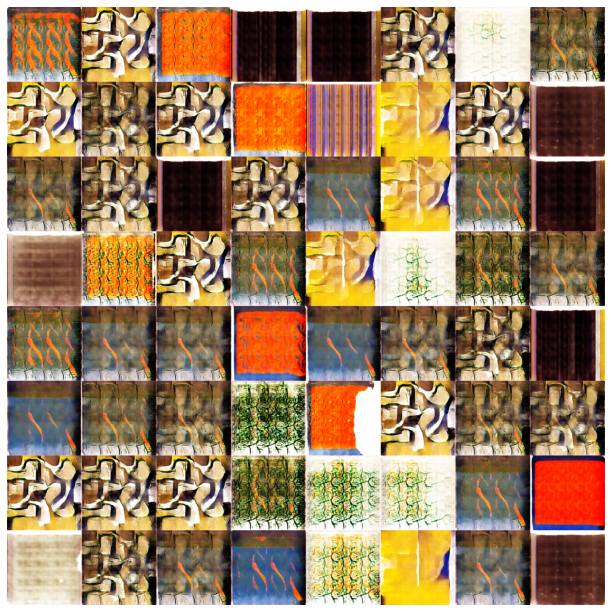

In [17]:
fig = plt.figure(figsize=(11,11))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

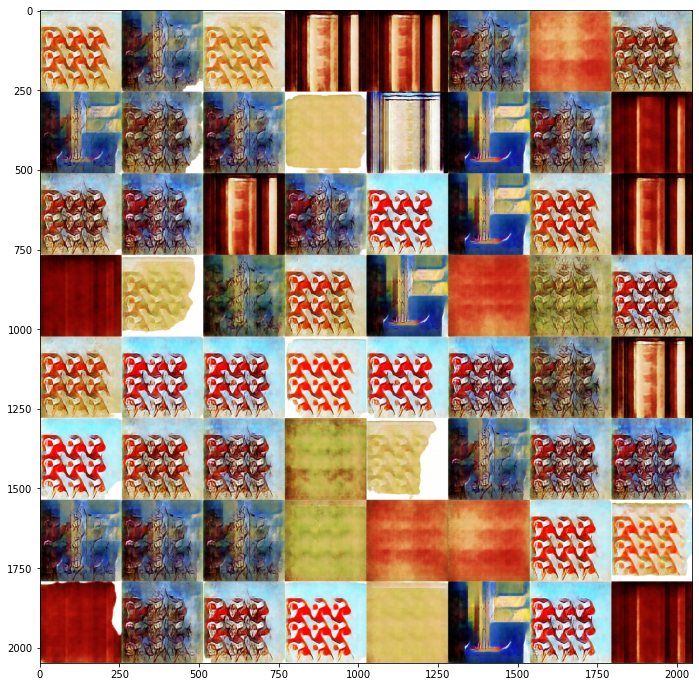

In [21]:
fixed_noise_1 = torch.randn(64, nz, 1, 1, device=device)
fake = netG(fixed_noise_1).detach().cpu()
plt.figure(figsize=(12,12))
plt.imshow(np.transpose(vutils.make_grid(img_list[8], padding=2, normalize=True), (1, 2, 0)))

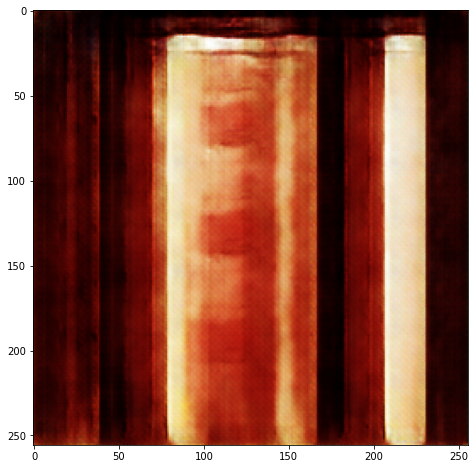

In [27]:
plt.figure(figsize=(8,8))
plt.imshow(np.transpose(vutils.make_grid(img_list[8][:, 2*256:3*256, 2*256:3*256], padding=0, normalize=True), (1, 2, 0)))
vutils.save_image(img_list[8][:, 2*256:3*256, 2*256:3*256], padding=0, normalize=True, fp = 'image.jpg')